Motion tracking of feature points and dense optical flow

In [ ]:
# !pip install numpy==1.18.3
# !pip install opencv-python==4.2.0.34
# !pip install opencv-contrib-python==4.2.0.34
#  Restart the session after installtion

In [ ]:
# !wget http://athos.vision.sztaki.hu/~mitya/education/iva/test-data/4_motion/fishes.avi
# !wget http://athos.vision.sztaki.hu/~mitya/education/iva/test-data/4_motion/motor.avi

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

In [ ]:
def lucas_kanade(video_path, corner_detection_params, optical_flow_params):
    cap = cv2.VideoCapture(video_path)
    color = np.random.randint(0, 255, (100, 3))
    ret, org_frame = cap.read()
    prev_gray = cv2.cvtColor(org_frame, cv2.COLOR_BGR2GRAY)
    p0 = cv2.goodFeaturesToTrack(prev_gray, mask=None, **corner_detection_params)

    mask = np.zeros_like(org_frame)
    
    while True:
        ret, frame = cap.read()
        if not ret:
            break
        if frame is not None:
            frame_gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
            # calculate optical flow
            p1, st, err = cv2.calcOpticalFlowPyrLK(
                prev_gray, frame_gray, p0, None, **optical_flow_params
            )
            # Select good points
            good_new = p1[st == 1]
            good_prev = p0[st == 1]
            # draw the tracks
            for i, (new, old) in enumerate(zip(good_new, good_prev)):
                a, b = new.ravel()
                c, d = old.ravel()
                mask = cv2.line(mask, (a, b), (c, d), color[i].tolist(), 2)
                frame = cv2.circle(frame, (a, b), 5, color[i].tolist(), -1)
            img = cv2.add(frame, mask)
            cv2_imshow(img)
            # Now update the previous frame and previous points
            prev_gray = frame_gray.copy()
            p0 = good_new.reshape(-1, 1, 2)

In [ ]:
def dense_optical_flow(video_path, params=[]):
    cap = cv2.VideoCapture(video_path)
    ret, prev_frame = cap.read()

    method = cv2.calcOpticalFlowFarneback

    hsv = np.zeros_like(prev_frame)
    hsv[..., 1] = 255

    prev_frame = cv2.cvtColor(prev_frame, cv2.COLOR_BGR2GRAY)

    while True:
        # Read the next frame
        ret, frame = cap.read()
        frame_copy = frame
        if not ret:
            break
        # Preprocessing for exact method
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        # Calculate Optical Flow
        flow = method(prev_frame, frame, None, *params)

        # Encoding: convert the algorithm's output into Polar coordinates
        mag, ang = cv2.cartToPolar(flow[..., 0], flow[..., 1])
        # Use Hue and Saturation to encode the Optical Flow
        hsv[..., 0] = ang * 180 / np.pi / 2
        hsv[..., 2] = cv2.normalize(mag, None, 0, 255, cv2.NORM_MINMAX)
        # Convert HSV image into BGR
        bgr = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)
        cv2_imshow(frame_copy)
        cv2_imshow(bgr)
        prev_frame = frame

In [ ]:
fishes="/content/fishes.avi"
motors="/content/motor.avi"

<ipython-input-41-4c1773dabf7d>:29: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  mask = cv2.line(mask, (a, b), (c, d), color[i].tolist(), 2)
<ipython-input-41-4c1773dabf7d>:30: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  frame = cv2.circle(frame, (a, b), 5, color[i].tolist(), -1)


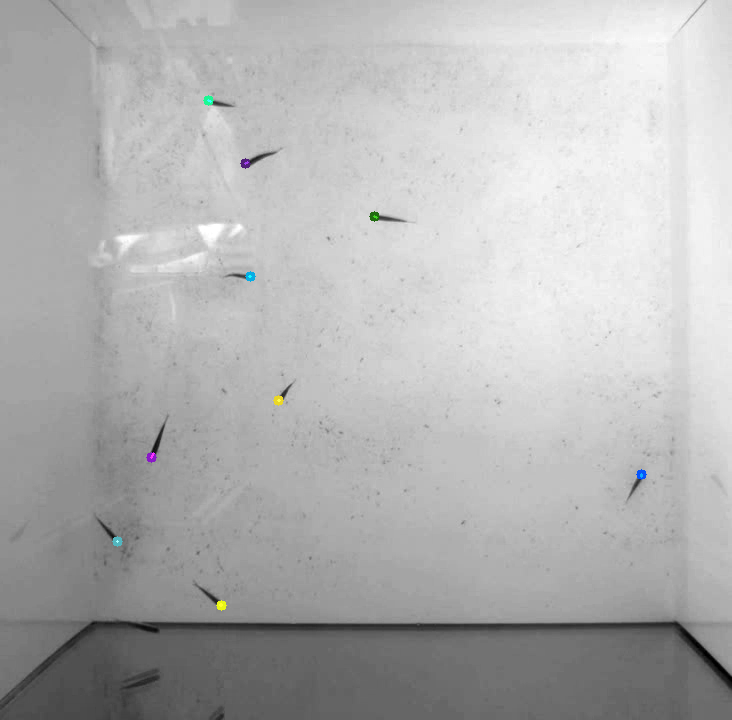

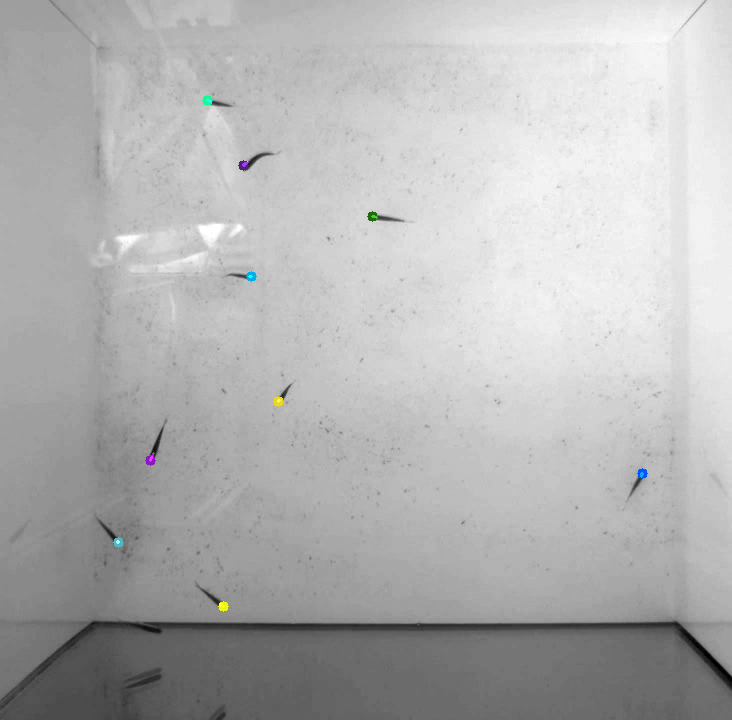

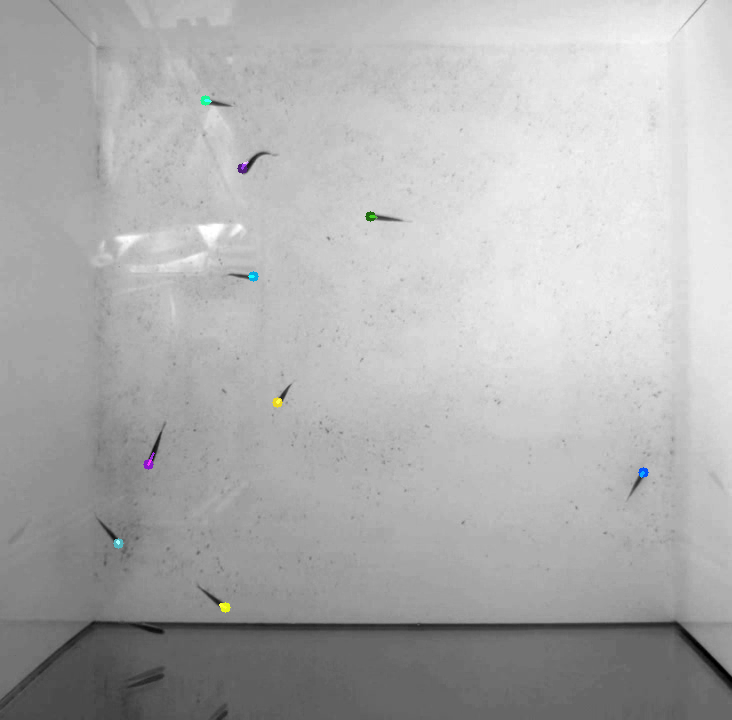

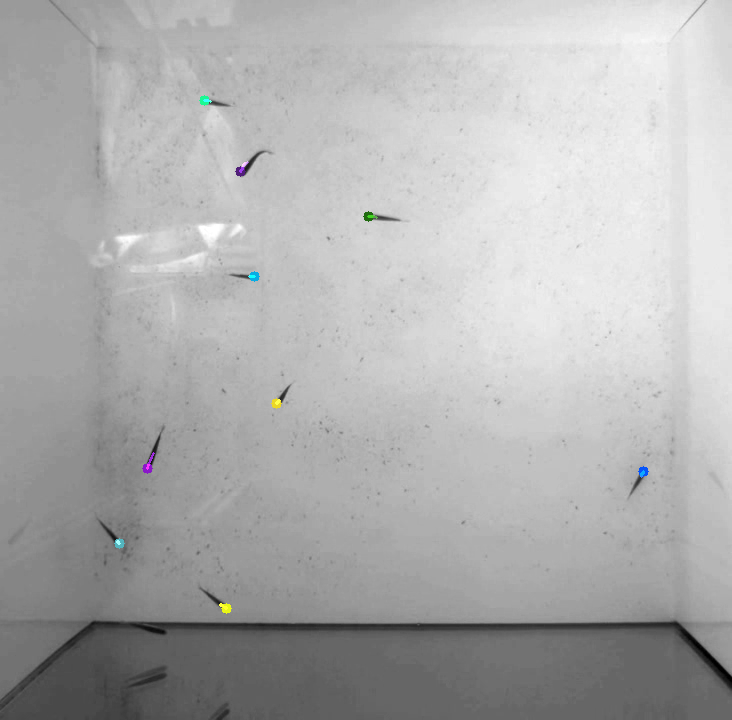

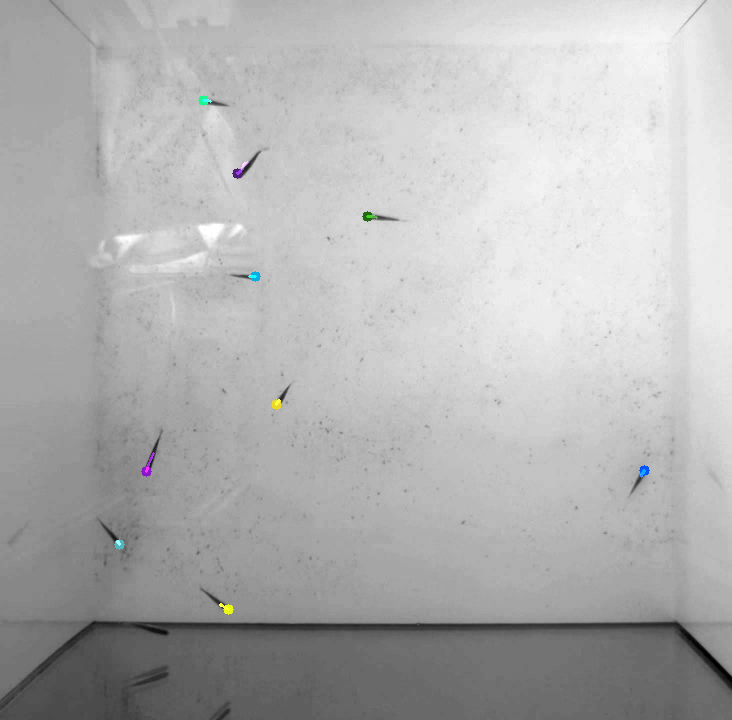

...

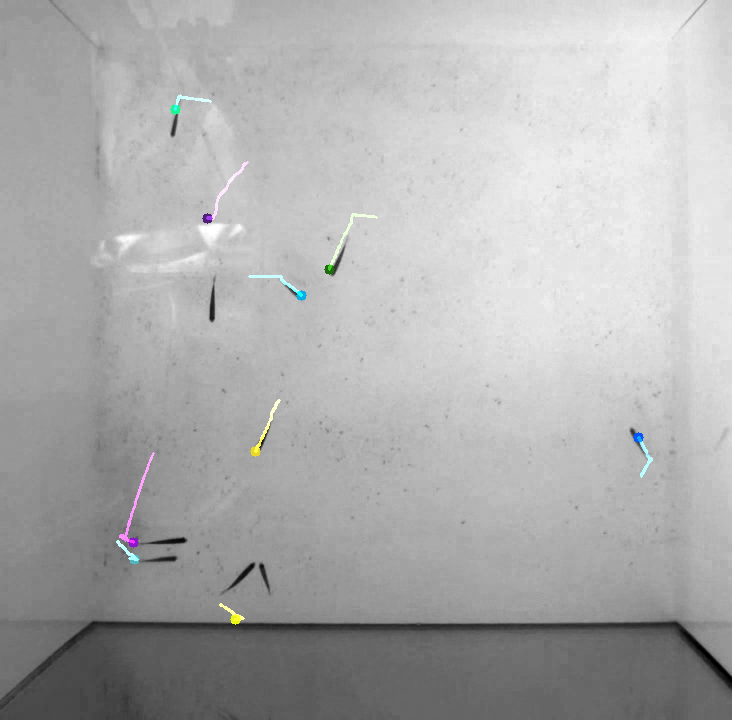

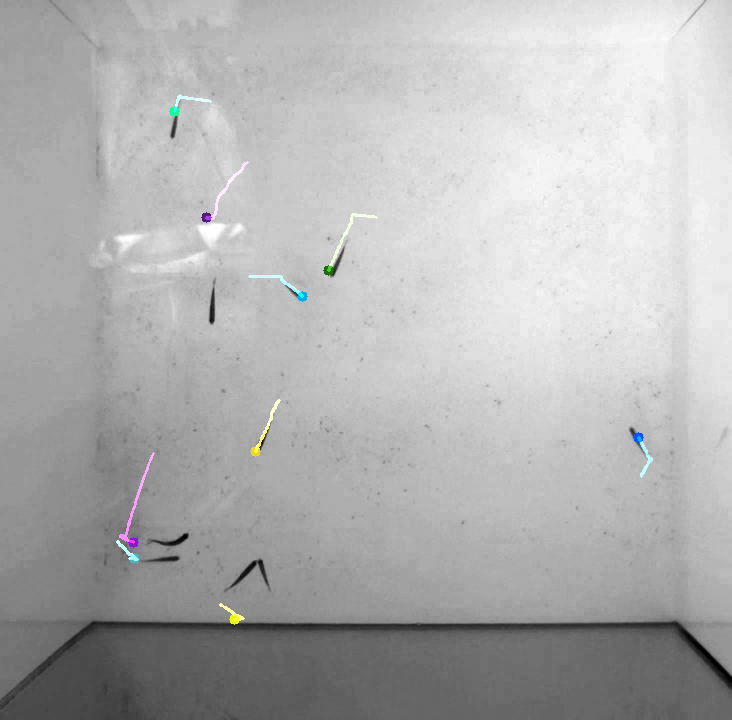

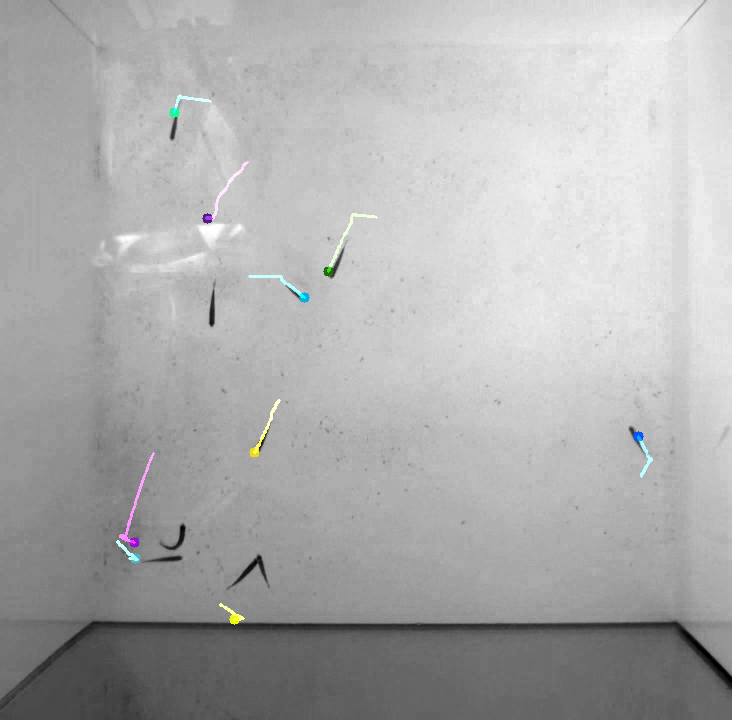

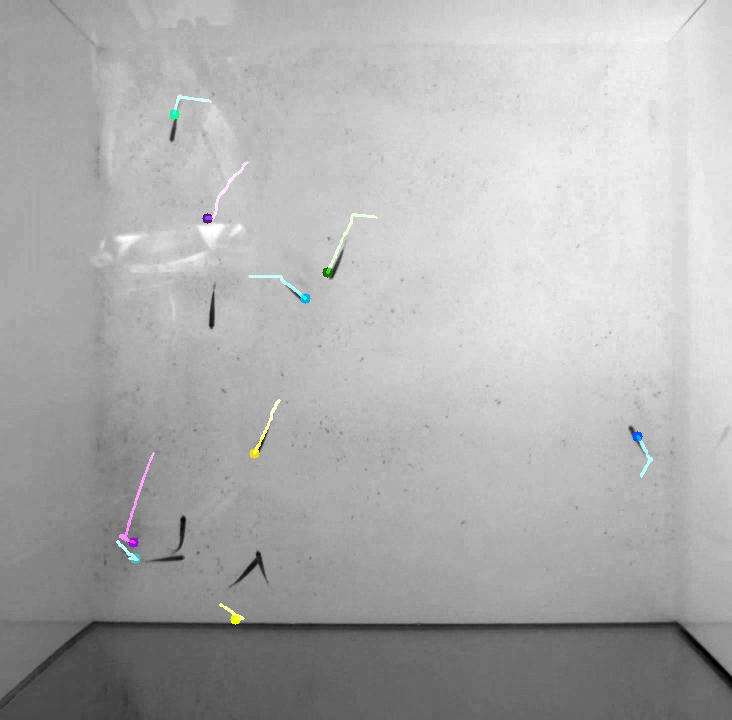

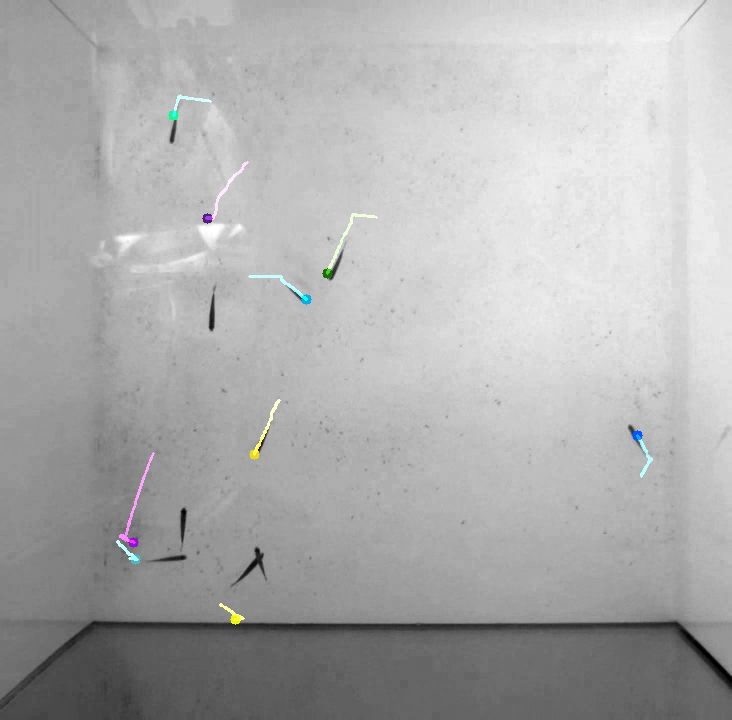

In [ ]:
# params for ShiTomasi corner detection
corner_detection_params = dict(maxCorners=100, qualityLevel=0.3, minDistance=7, blockSize=7)
# Parameters for lucas kanade optical flow
optical_flow_params = dict(
    winSize=(15, 15),
    maxLevel=2,
    criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 10, 0.03),
)
lucas_kanade(fishes, corner_detection_params, optical_flow_params)

<ipython-input-41-4c1773dabf7d>:29: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  mask = cv2.line(mask, (a, b), (c, d), color[i].tolist(), 2)
<ipython-input-41-4c1773dabf7d>:30: DeprecationWarning: an integer is required (got type numpy.float32).  Implicit conversion to integers using __int__ is deprecated, and may be removed in a future version of Python.
  frame = cv2.circle(frame, (a, b), 5, color[i].tolist(), -1)


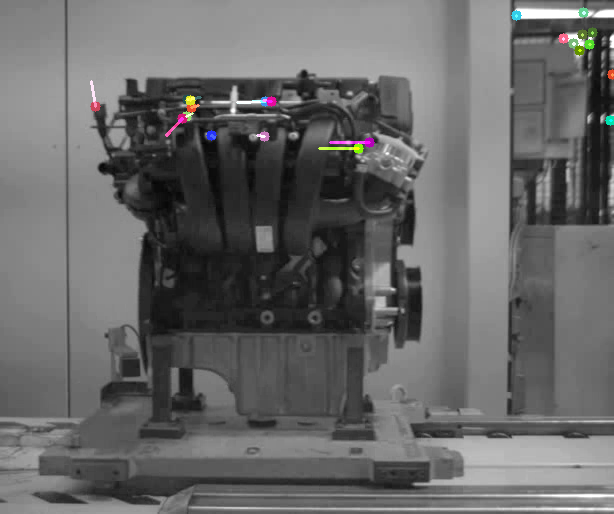

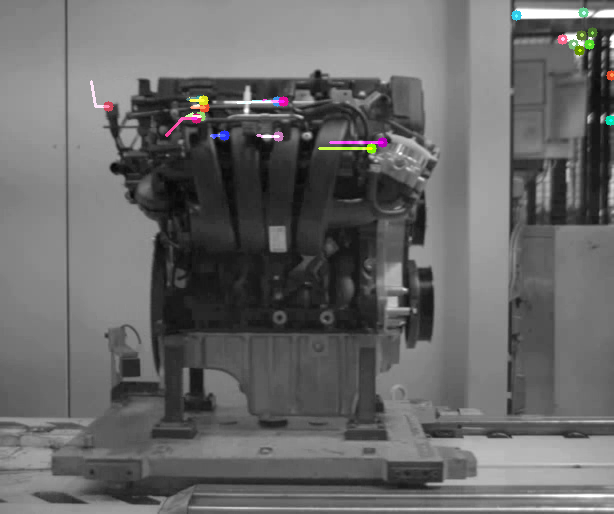

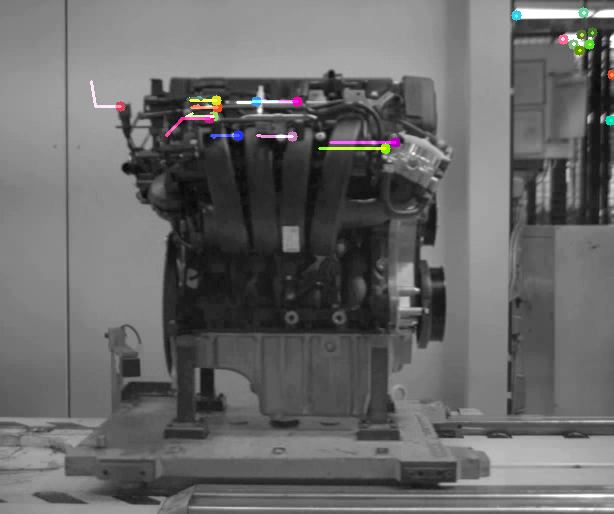

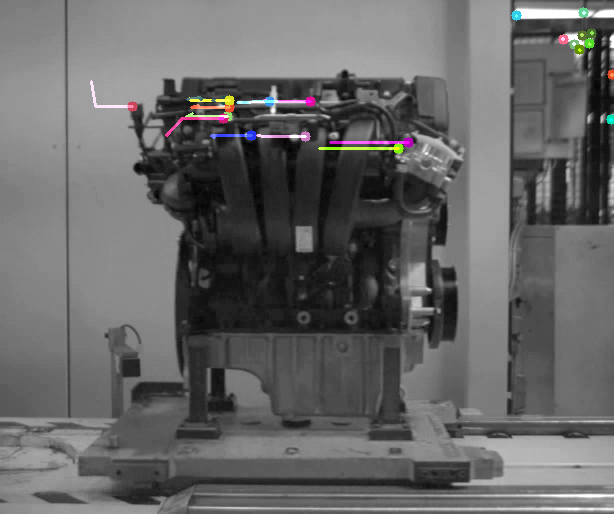

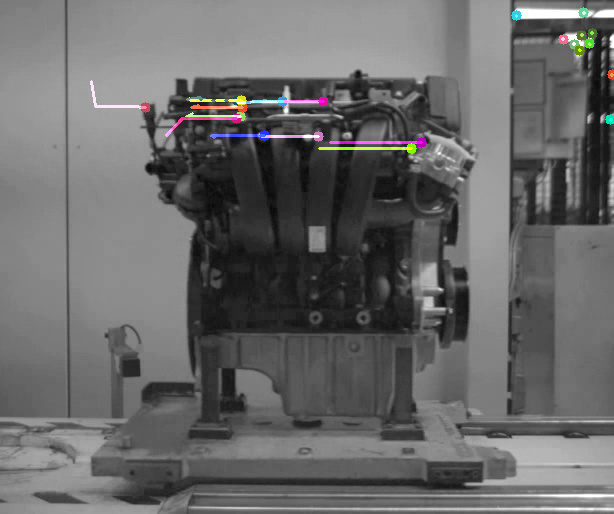

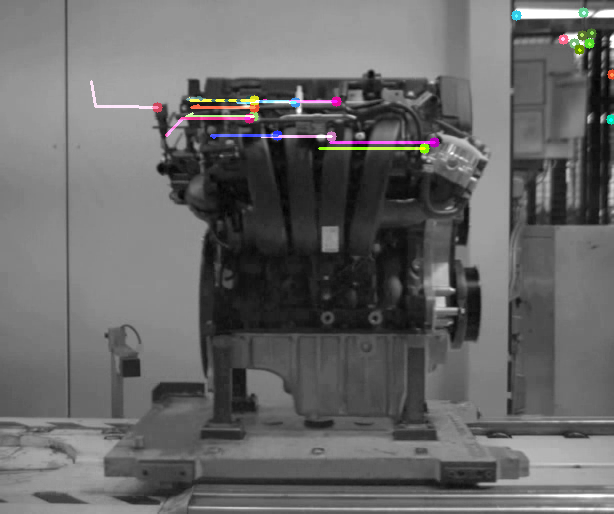

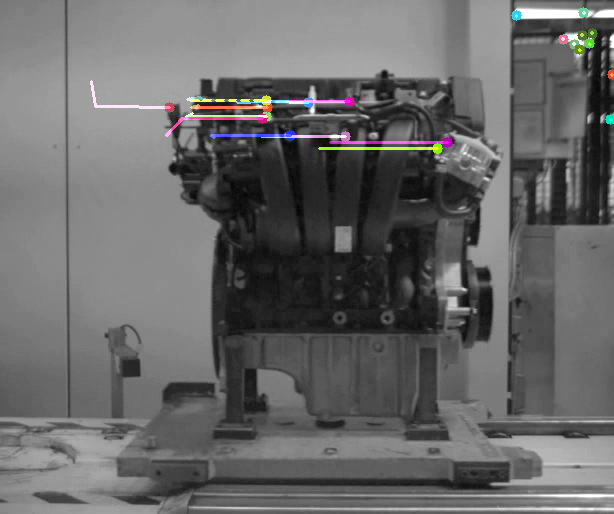

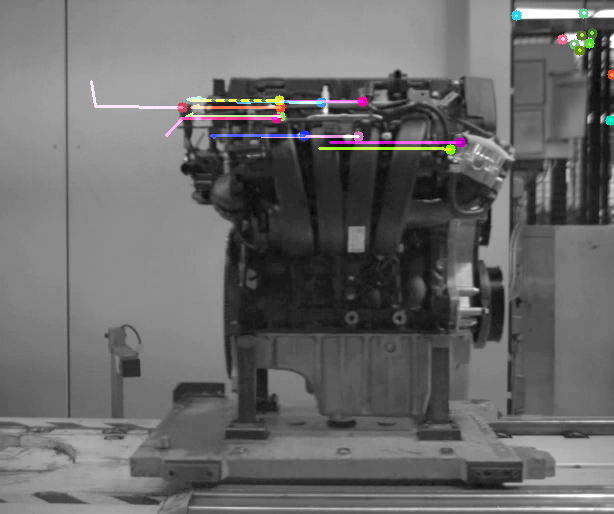

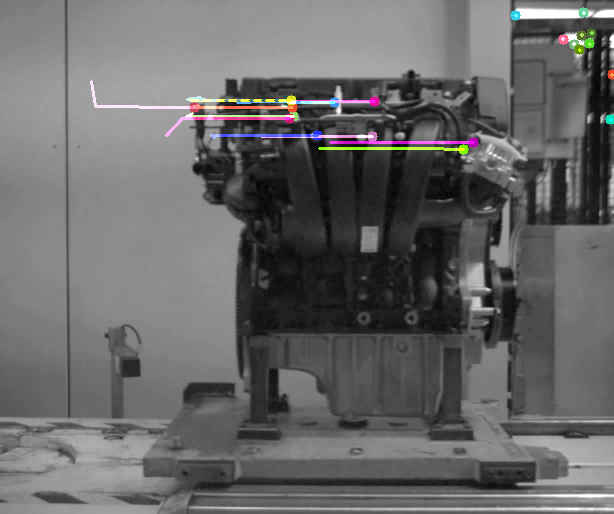

In [ ]:
lucas_kanade(motors, corner_detection_params, optical_flow_params)

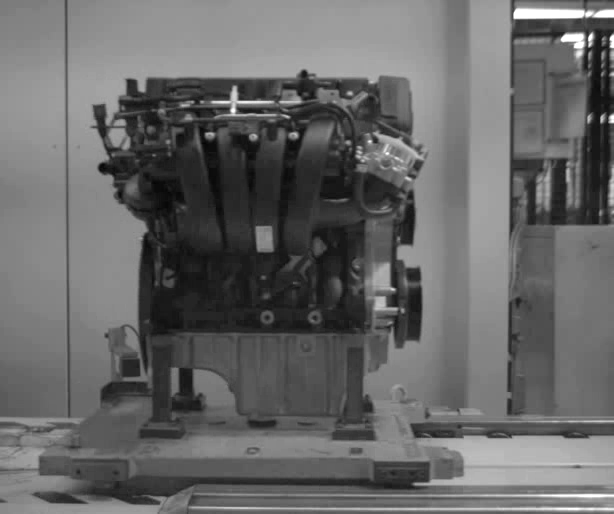

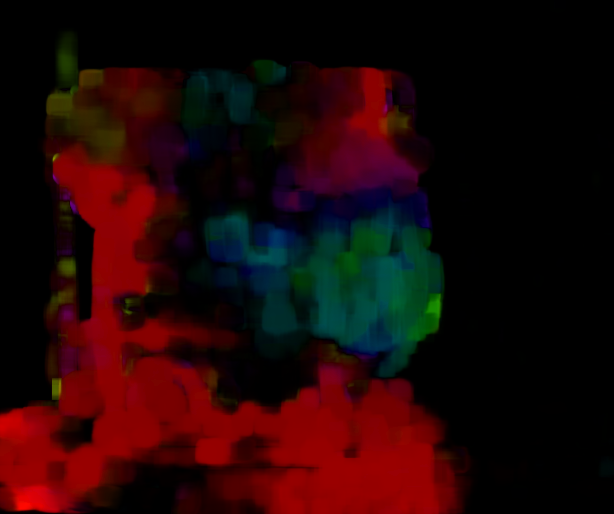

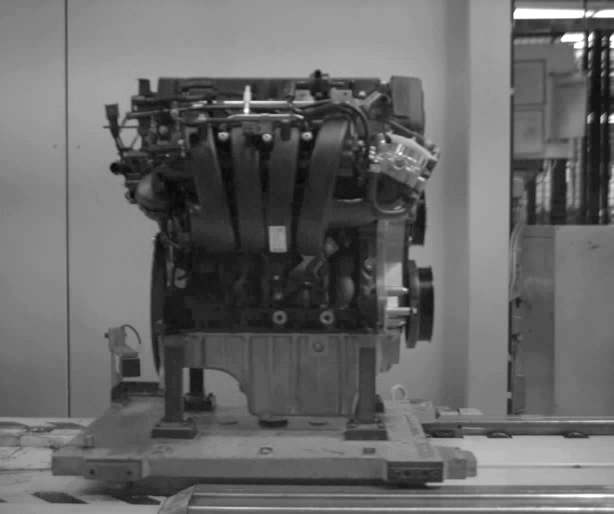

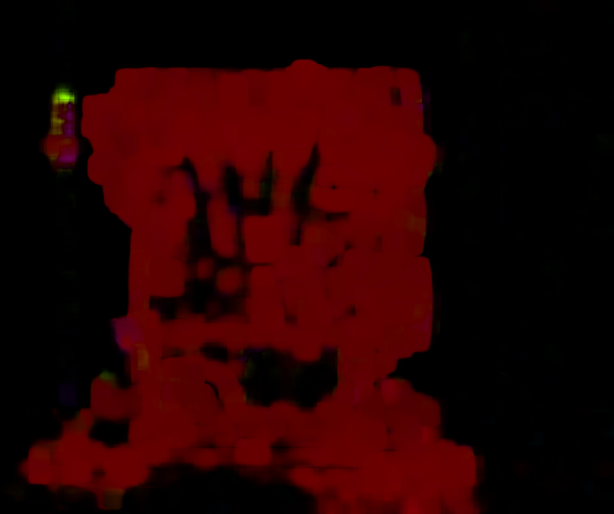

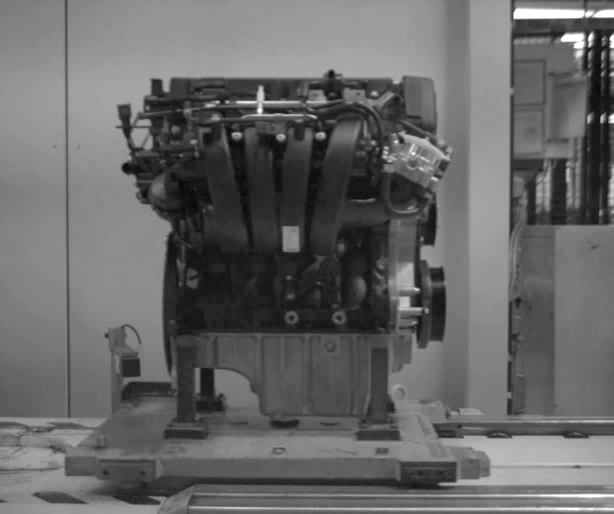

...

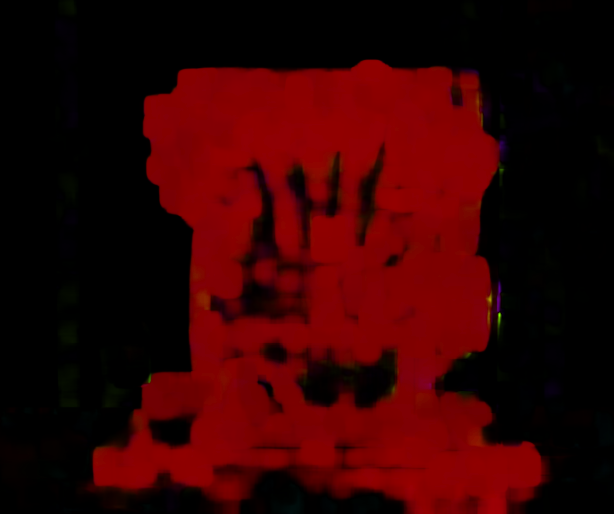

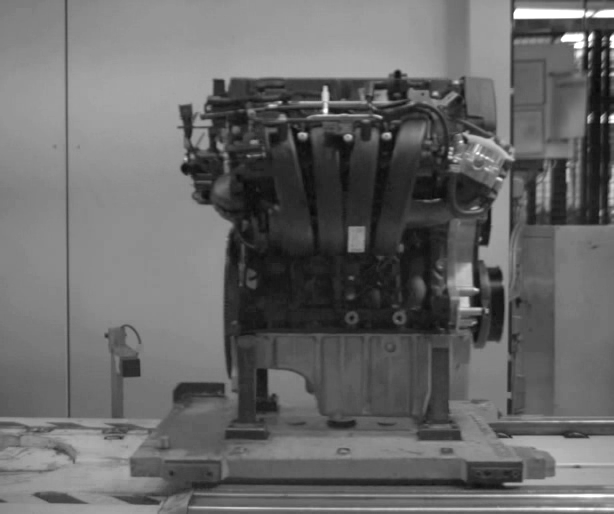

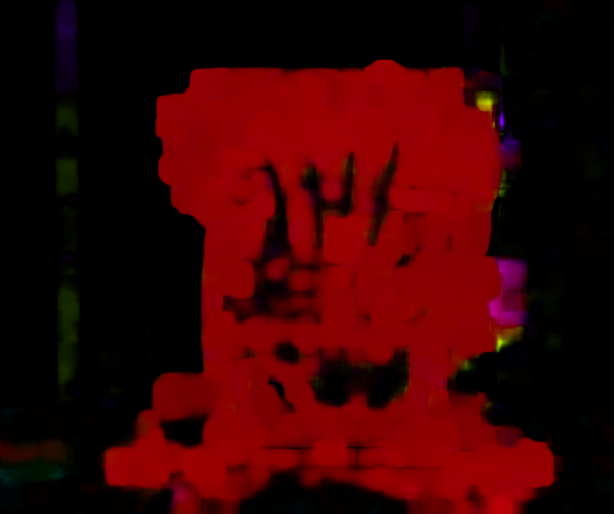

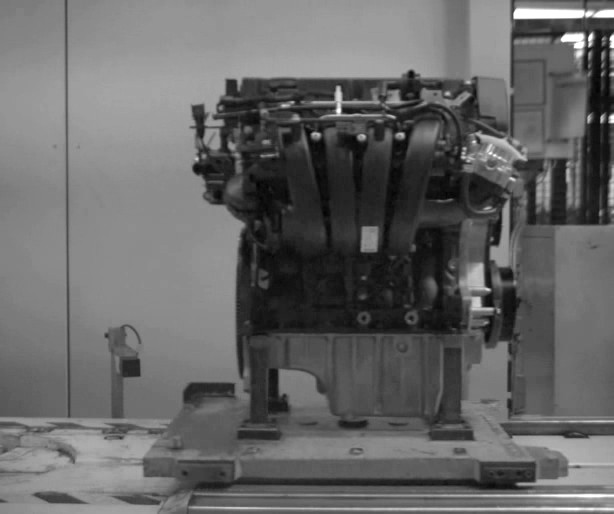

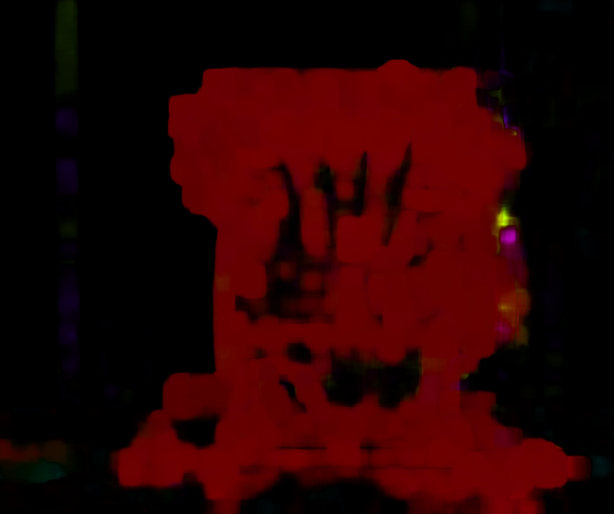

In [ ]:
params = [0.5, 3, 15, 3, 5, 1.2, 0] #Farneback
dense_optical_flow(motors, params)